In [1]:
import json
import sys
sys.path.append('./home/nbuser/library')

import pandas as pd
pd.options.mode.chained_assignment = None
import requests
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
    properties = pd.read_csv('Properties.csv')
    properties

,Bedrooms,Bathrooms,Address,Land area,CV,Latitude,Longitude,SA1,0-19 years,20-29 years,30-39 years,40-49 years,50-59 years,60+ years,Suburbs
0,5,3.0,"106 Lawrence Crescent Hill Park, Auckland",714,960000,-37.012920,174.904069,7009770,48,27,24,21,24,21,Manurewa
1,5,3.0,"8 Corsica Way Karaka, Auckland",564,1250000,-37.063672,174.922912,7009991,42,18,12,21,15,30,Karaka
2,6,4.0,"243 Harbourside Drive Karaka, Auckland",626,1250000,-37.063580,174.924044,7009991,42,18,12,21,15,30,Karaka
3,2,1.0,"2/30 Hardington Street Onehunga, Auckland",65,740000,-36.912996,174.787425,7007871,42,6,21,21,12,15,Onehunga
4,3,1.0,"59 Israel Avenue Clover Park, Auckland",601,630000,-36.979037,174.892612,7008902,93,27,33,30,21,33,Clover Park
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1046,4,1.0,"19 Landscape Road, Auckland",1368 m²,670000,-36.899255,174.761165,7005464,54,18,15,24,21,27,Mount Eden
1047,6,1.0,"56 Galway Street, Auckland",607 m²,1200000,-36.844933,174.770001,7005497,15,27,24,15,18,30,Auckland Central
1048,5,3.0,"28A Hayr Road, Auckland",453 m²,1250000,-36.912242,174.756726,7007758,36,30,45,21,24,21,Three Kings
1049,5,2.0,"27 Market Road, Auckland",1854 m²,5300000,-36.879665,174.787668,7005745,48,18,12,15,36,45,Remuera


In [3]:
def getCurrentPop(lng, lat):

    url = 'https://koordinates.com/services/query/v1/vector.json'

    params = {
        'key' : 'eea21f5c0d2840be847c81d45ddc8377',
        'layer' : 104612,
        'x' : lng,
        'y' : lat
    }

    response = requests.get(url, params = params)

    if response.status_code != 200:
        return pd.Series({'Population' : response.status_code})

    return response.json()['vectorQuery']['layers']['104612']['features'][0]['properties']['C18_CURPop']

In [4]:
def getEuropeanPop(lng, lat):

    url = 'https://koordinates.com/services/query/v1/vector.json'

    params = {
        'key' : 'eea21f5c0d2840be847c81d45ddc8377',
        'layer' : 104612,
        'x' : lng,
        'y' : lat
    }

    response = requests.get(url, params = params)

    if response.status_code != 200:
        return pd.Series({'Population' : response.status_code})

    europeanPop = response.json()['vectorQuery']['layers']['104612']['features'][0]['properties']['C18_Ethnicity_L1_European']

    return europeanPop

In [5]:
def getMaoriPop(lng, lat):

    url = 'https://koordinates.com/services/query/v1/vector.json'

    params = {
        'key' : 'eea21f5c0d2840be847c81d45ddc8377',
        'layer' : 104612,
        'x' : lng,
        'y' : lat
    }

    response = requests.get(url, params = params)

    if response.status_code != 200:
        return pd.Series({'Population' : response.status_code})

    maoriPop = response.json()['vectorQuery']['layers']['104612']['features'][0]['properties']['C18_Ethnicity_L1_Maori']

    return maoriPop

In [6]:
def getPacificPop(lng, lat):

    url = 'https://koordinates.com/services/query/v1/vector.json'

    params = {
        'key' : 'eea21f5c0d2840be847c81d45ddc8377',
        'layer' : 104612,
        'x' : lng,
        'y' : lat
    }

    response = requests.get(url, params = params)

    if response.status_code != 200:
        return pd.Series({'Population' : response.status_code})

    pacificPop = response.json()['vectorQuery']['layers']['104612']['features'][0]['properties']['C18_Ethnicity_L1_Pacific_Ppls']

    return pacificPop

In [7]:
def getAsianPop(lng, lat):

    url = 'https://koordinates.com/services/query/v1/vector.json'

    params = {
        'key' : 'eea21f5c0d2840be847c81d45ddc8377',
        'layer' : 104612,
        'x' : lng,
        'y' : lat
    }

    response = requests.get(url, params = params)

    if response.status_code != 200:
        return pd.Series({'Population' : response.status_code})

    asianPop = response.json()['vectorQuery']['layers']['104612']['features'][0]['properties']['C18_Ethnicity_L1_Asian']

    return asianPop

In [8]:
def getMELAAPop(lng, lat):
    # MELAA refers to Middle Eastern/Latin American/African
    url = 'https://koordinates.com/services/query/v1/vector.json'

    params = {
        'key' : 'eea21f5c0d2840be847c81d45ddc8377',
        'layer' : 104612,
        'x' : lng,
        'y' : lat
    }

    response = requests.get(url, params = params)

    if response.status_code != 200:
        return pd.Series({'Population' : response.status_code})

    MELAAPop = response.json()['vectorQuery']['layers']['104612']['features'][0]['properties']['C18_Ethnicity_L1_MELAA']

    return MELAAPop

In [9]:
def getNZPop(lng, lat):

    url = 'https://koordinates.com/services/query/v1/vector.json'

    params = {
        'key' : 'eea21f5c0d2840be847c81d45ddc8377',
        'layer' : 104612,
        'x' : lng,
        'y' : lat
    }

    response = requests.get(url, params = params)

    if response.status_code != 200:
        return pd.Series({'Population' : response.status_code})

    NZPop = response.json()['vectorQuery']['layers']['104612']['features'][0]['properties']['C18_Ethnicity_L2_New_Zealander']

    return NZPop

In [10]:
properties['SA Population'] = properties.apply(lambda x: getCurrentPop(x['Longitude'], x['Latitude']), axis=1)


In [11]:
# fetch european population
properties['European Population'] = properties.apply(lambda x: getEuropeanPop(x['Longitude'], x['Latitude']), axis=1)

In [12]:
# fetch maori population
properties['Maori Population'] = properties.apply(lambda x: getMaoriPop(x['Longitude'], x['Latitude']), axis=1)

In [13]:
# fetch pacific popluation
properties['Pacific Population'] = properties.apply(lambda x: getPacificPop(x['Longitude'], x['Latitude']), axis=1)

In [14]:
# fetch asian population
properties['Asian Population'] = properties.apply(lambda x: getAsianPop(x['Longitude'], x['Latitude']), axis=1)

In [15]:
# fetch MELAA population
properties['MELAA Population'] = properties.apply(lambda x: getMELAAPop(x['Longitude'], x['Latitude']), axis=1)

In [16]:
# fetch NZ poplulation
properties['NZ Population'] = properties.apply(lambda x: getNZPop(x['Longitude'], x['Latitude']), axis=1)

In [17]:
properties

,Bedrooms,Bathrooms,Address,Land area,CV,Latitude,Longitude,SA1,0-19 years,20-29 years,...,50-59 years,60+ years,Suburbs,SA Population,European Population,Maori Population,Pacific Population,Asian Population,MELAA Population,NZ Population
0,5,3.0,"106 Lawrence Crescent Hill Park, Auckland",714,960000,-37.012920,174.904069,7009770,48,27,...,24,21,Manurewa,174,72,30,51,54,9,0
1,5,3.0,"8 Corsica Way Karaka, Auckland",564,1250000,-37.063672,174.922912,7009991,42,18,...,15,30,Karaka,129,87,21,12,30,0,0
2,6,4.0,"243 Harbourside Drive Karaka, Auckland",626,1250000,-37.063580,174.924044,7009991,42,18,...,15,30,Karaka,129,87,21,12,30,0,0
3,2,1.0,"2/30 Hardington Street Onehunga, Auckland",65,740000,-36.912996,174.787425,7007871,42,6,...,12,15,Onehunga,120,90,9,15,21,6,0
4,3,1.0,"59 Israel Avenue Clover Park, Auckland",601,630000,-36.979037,174.892612,7008902,93,27,...,21,33,Clover Park,231,15,48,177,36,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1046,4,1.0,"19 Landscape Road, Auckland",1368 m²,670000,-36.899255,174.761165,7005464,54,18,...,21,27,Mount Eden,159,90,3,3,75,0,0
1047,6,1.0,"56 Galway Street, Auckland",607 m²,1200000,-36.844933,174.770001,7005497,15,27,...,18,30,Auckland Central,129,84,6,3,30,12,0
1048,5,3.0,"28A Hayr Road, Auckland",453 m²,1250000,-36.912242,174.756726,7007758,36,30,...,24,21,Three Kings,180,48,3,21,111,6,0
1049,5,2.0,"27 Market Road, Auckland",1854 m²,5300000,-36.879665,174.787668,7005745,48,18,...,36,45,Remuera,174,129,6,6,42,0,0


In [18]:
nzdep2018 = pd.read_csv('nzdep2018.csv')
# drop columns from nzdep2018 dataframe
nzdep2018 = nzdep2018.drop(columns=['SA22018_code', 'SA22018_name', 'URPopnSA1_2018'])
propertiesDeprivation = pd.merge(properties, nzdep2018, how='left', left_on='SA1', right_on='SA12018_code')
propertiesDeprivation

,Bedrooms,Bathrooms,Address,Land area,CV,Latitude,Longitude,SA1,0-19 years,20-29 years,...,SA Population,European Population,Maori Population,Pacific Population,Asian Population,MELAA Population,NZ Population,SA12018_code,NZDep2018,NZDep2018_Score
0,5,3.0,"106 Lawrence Crescent Hill Park, Auckland",714,960000,-37.012920,174.904069,7009770,48,27,...,174,72,30,51,54,9,0,7009770,6.0,997.0
1,5,3.0,"8 Corsica Way Karaka, Auckland",564,1250000,-37.063672,174.922912,7009991,42,18,...,129,87,21,12,30,0,0,7009991,1.0,881.0
2,6,4.0,"243 Harbourside Drive Karaka, Auckland",626,1250000,-37.063580,174.924044,7009991,42,18,...,129,87,21,12,30,0,0,7009991,1.0,881.0
3,2,1.0,"2/30 Hardington Street Onehunga, Auckland",65,740000,-36.912996,174.787425,7007871,42,6,...,120,90,9,15,21,6,0,7007871,2.0,908.0
4,3,1.0,"59 Israel Avenue Clover Park, Auckland",601,630000,-36.979037,174.892612,7008902,93,27,...,231,15,48,177,36,0,0,7008902,9.0,1091.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1046,4,1.0,"19 Landscape Road, Auckland",1368 m²,670000,-36.899255,174.761165,7005464,54,18,...,159,90,3,3,75,0,0,7005464,1.0,885.0
1047,6,1.0,"56 Galway Street, Auckland",607 m²,1200000,-36.844933,174.770001,7005497,15,27,...,129,84,6,3,30,12,0,7005497,6.0,981.0
1048,5,3.0,"28A Hayr Road, Auckland",453 m²,1250000,-36.912242,174.756726,7007758,36,30,...,180,48,3,21,111,6,0,7007758,6.0,976.0
1049,5,2.0,"27 Market Road, Auckland",1854 m²,5300000,-36.879665,174.787668,7005745,48,18,...,174,129,6,6,42,0,0,7005745,1.0,891.0


## Data Cleaning

In [19]:
# reduce dimensionality of dataset
propertiesDeprivation = propertiesDeprivation.drop(columns=['Latitude', 'Longitude', 'SA1', 'SA12018_code', 'NZDep2018_Score'])

In [20]:
# remove m2 from land area value
propertiesDeprivation['Land area'] = propertiesDeprivation['Land area'].str.extract('(\d+)')

In [21]:
propertiesDeprivation.isnull().sum()

Bedrooms               0
Bathrooms              2
Address                0
Land area              0
CV                     0
0-19 years             0
20-29 years            0
30-39 years            0
40-49 years            0
50-59 years            0
60+ years              0
Suburbs                1
SA Population          0
European Population    0
Maori Population       0
Pacific Population     0
Asian Population       0
MELAA Population       0
NZ Population          0
NZDep2018              0
dtype: int64

In [22]:
isNaN = propertiesDeprivation.isnull()
rowhasNaN = isNaN.any(axis=1)
rowswithNaN = properties[rowhasNaN]

print(rowswithNaN)

Bedrooms  Bathrooms                                            Address  \
309         4        NaN                  14 Hea Road Hobsonville, Auckland   
311         4        NaN                  16 Hea Road Hobsonville, Auckland   
568         1        1.0  14 Te Rangitawhiri Road Great Barrier Island, ...   

    Land area       CV   Latitude   Longitude      SA1  0-19 years  \
309       214  1250000 -36.798371  174.647430  7002267          60   
311       245  1100000 -36.798371  174.647430  7002267          60   
568      2141   740000 -36.197282  175.416921  7001131          27   

     20-29 years  ...  50-59 years  60+ years      Suburbs  SA Population  \
309           66  ...           24         18  Hobsonville            252   
311           66  ...           24         18  Hobsonville            252   
568            6  ...           39         60          NaN            156   

    European Population  Maori Population  Pacific Population  \
309                 129          

In [34]:
propertiesDeprivation = propertiesDeprivation.drop(propertiesDeprivation.index[[309,311,568]])

In [35]:
propertiesDeprivation.describe()

,Bedrooms,Bathrooms,Land area,CV,0-19 years,20-29 years,30-39 years,40-49 years,50-59 years,60+ years,SA Population,European Population,Maori Population,Pacific Population,Asian Population,MELAA Population,NZ Population,NZDep2018
count,1048.000000,1048.000000,1048.000000,1.048000e+03,1048.000000,1048.000000,1048.00000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000,1048.000000
mean,3.779580,2.074427,856.961832,1.388544e+06,47.544847,28.915076,27.00000,24.131679,22.597328,29.353053,179.799618,96.226145,19.906489,24.400763,51.787214,3.068702,-10.311069,5.065840
std,1.167894,0.992904,1589.698071,1.184422e+06,24.713408,20.993232,17.93158,10.956798,10.212455,21.810055,71.087298,61.745181,38.219854,47.857354,62.671667,31.393352,106.476836,2.912027
min,1.000000,1.000000,40.000000,2.700000e+05,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,3.000000,-999.000000,-999.000000,-999.000000,-999.000000,-999.000000,-999.000000,1.000000
25%,3.000000,1.000000,323.000000,7.800000e+05,33.000000,15.000000,15.00000,18.000000,15.000000,18.000000,138.000000,57.000000,6.000000,3.000000,18.000000,0.000000,0.000000,2.000000
50%,4.000000,2.000000,571.500000,1.080000e+06,45.000000,24.000000,24.00000,24.000000,21.000000,27.000000,174.000000,96.000000,15.000000,12.000000,39.000000,3.000000,0.000000,5.000000
75%,4.000000,3.000000,825.000000,1.600000e+06,57.000000,36.000000,33.00000,30.000000,27.000000,36.000000,207.750000,129.000000,27.000000,33.000000,72.000000,6.000000,3.000000,8.000000
max,17.000000,8.000000,22240.000000,1.800000e+07,201.000000,270.000000,177.00000,114.000000,90.000000,483.000000,789.000000,471.000000,165.000000,276.000000,591.000000,51.000000,33.000000,10.000000


In [42]:
propertiesDeprivation[propertiesDeprivation['NZ Population'] == (-999)]

,Bedrooms,Bathrooms,Address,Land area,CV,0-19 years,20-29 years,30-39 years,40-49 years,50-59 years,60+ years,Suburbs,SA Population,European Population,Maori Population,Pacific Population,Asian Population,MELAA Population,NZ Population,NZDep2018
83,5,3,"144 Arran Point Parade Orewa, Auckland",519,540000,0,0,0,0,0,0,Orewa,18,15,6,0,3,0,-999,7.0
84,4,2,"106 Godfrey Drive Orewa, Auckland",650,590000,0,0,0,0,0,0,Orewa,18,15,6,0,3,0,-999,7.0
85,4,2,"135 Godfrey Drive Orewa, Auckland",602,1075000,0,0,0,0,0,0,Orewa,18,15,6,0,3,0,-999,7.0
86,5,3,"17 Davey Crescent Orewa, Auckland",650,1250000,0,0,0,0,0,0,Orewa,18,15,6,0,3,0,-999,7.0
87,5,3,"32 Cassidy Drive Orewa, Auckland",519,1225000,0,0,0,0,0,0,Orewa,18,15,6,0,3,0,-999,7.0
88,5,3,"130 Arran Point Parade Orewa, Auckland",522,540000,0,0,0,0,0,0,Orewa,18,15,6,0,3,0,-999,7.0
89,5,3,"7 Maka Terrace Orewa, Auckland",651,1260000,0,0,0,0,0,0,Orewa,18,15,6,0,3,0,-999,7.0
90,4,2,"111 Godfrey Drive Orewa, Auckland",559,1050000,0,0,0,0,0,0,Orewa,18,15,6,0,3,0,-999,7.0
608,3,2,"69 Wainui Road Silverdale, Auckland",532,1300000,0,0,0,0,0,0,Silverdale,21,9,6,0,3,0,-999,8.0
627,3,2,"25 Ocean View Crescent Rakino Island, Auckland",1366,270000,0,0,0,0,0,6,Rakino Island,27,27,3,0,0,3,-999,6.0


In [77]:
propertiesDeprivation = propertiesDeprivation.drop(propertiesDeprivation[(propertiesDeprivation['NZ Population'] == -999)].index)

In [78]:
propertiesDeprivation.describe()

,Bedrooms,Bathrooms,Land area,CV,0-19 years,20-29 years,30-39 years,40-49 years,50-59 years,60+ years,SA Population,European Population,Maori Population,Pacific Population,Asian Population,MELAA Population,NZ Population,NZDep2018
count,1036.000000,1036.000000,1036.000000,1.036000e+03,1036.000000,1036.000000,1036.000000,1036.000000,1036.000000,1036.000000,1036.000000,1036.000000,1036.000000,1036.000000,1036.000000,1036.000000,1036.000000,1036.000000
mean,3.777027,2.071429,860.313707,1.392359e+06,48.095560,29.250000,27.312741,24.411197,22.859073,29.681467,181.667954,98.128378,21.043436,25.647683,53.325290,4.062741,1.140927,5.050193
std,1.169456,0.995989,1598.253562,1.187959e+06,24.317099,20.881082,17.796615,10.705763,9.975691,21.718820,69.328691,51.249225,21.704895,36.014790,53.648988,5.070796,2.021963,2.919432
min,1.000000,1.000000,43.000000,2.800000e+05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,30.000000,9.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,3.000000,1.000000,322.000000,7.800000e+05,33.000000,18.000000,15.000000,18.000000,15.000000,18.000000,138.000000,60.000000,9.000000,3.000000,21.000000,0.000000,0.000000,2.000000
50%,4.000000,2.000000,572.500000,1.080000e+06,45.000000,25.500000,24.000000,24.000000,21.000000,27.000000,174.000000,96.000000,15.000000,12.000000,39.000000,3.000000,0.000000,5.000000
75%,4.000000,3.000000,826.250000,1.605000e+06,57.000000,36.000000,33.000000,30.000000,27.000000,36.000000,210.000000,129.000000,27.000000,33.000000,72.000000,6.000000,3.000000,8.000000
max,17.000000,8.000000,22240.000000,1.800000e+07,201.000000,270.000000,177.000000,114.000000,90.000000,483.000000,789.000000,471.000000,165.000000,276.000000,591.000000,51.000000,33.000000,10.000000


In [79]:
propertiesDeprivation.dtypes

Bedrooms                 int64
Bathrooms                int64
Address                 object
Land area                int64
CV                       int64
0-19 years               int64
20-29 years              int64
30-39 years              int64
40-49 years              int64
50-59 years              int64
60+ years                int64
Suburbs                 object
SA Population            int64
European Population      int64
Maori Population         int64
Pacific Population       int64
Asian Population         int64
MELAA Population         int64
NZ Population            int64
NZDep2018              float64
dtype: object

In [80]:
propertiesDeprivation['Bathrooms'] = propertiesDeprivation['Bathrooms'].astype(np.int64)

In [81]:
propertiesDeprivation['Land area'] = propertiesDeprivation['Land area'].astype(np.int64)

In [82]:
propertiesDeprivation.dtypes

Bedrooms                 int64
Bathrooms                int64
Address                 object
Land area                int64
CV                       int64
0-19 years               int64
20-29 years              int64
30-39 years              int64
40-49 years              int64
50-59 years              int64
60+ years                int64
Suburbs                 object
SA Population            int64
European Population      int64
Maori Population         int64
Pacific Population       int64
Asian Population         int64
MELAA Population         int64
NZ Population            int64
NZDep2018              float64
dtype: object

array([[<AxesSubplot:title={'center':'0-19 years'}>,
        <AxesSubplot:title={'center':'20-29 years'}>,
        <AxesSubplot:title={'center':'30-39 years'}>,
        <AxesSubplot:title={'center':'40-49 years'}>],
       [<AxesSubplot:title={'center':'50-59 years'}>,
        <AxesSubplot:title={'center':'60+ years'}>,
        <AxesSubplot:title={'center':'Asian Population'}>,
        <AxesSubplot:title={'center':'Bathrooms'}>],
       [<AxesSubplot:title={'center':'Bedrooms'}>,
        <AxesSubplot:title={'center':'CV'}>,
        <AxesSubplot:title={'center':'European Population'}>,
        <AxesSubplot:title={'center':'Land area'}>],
       [<AxesSubplot:title={'center':'MELAA Population'}>,
        <AxesSubplot:title={'center':'Maori Population'}>,
        <AxesSubplot:title={'center':'NZ Population'}>,
        <AxesSubplot:title={'center':'NZDep2018'}>],
       [<AxesSubplot:title={'center':'Pacific Population'}>,
        <AxesSubplot:title={'center':'SA Population'}>, <AxesSubplo

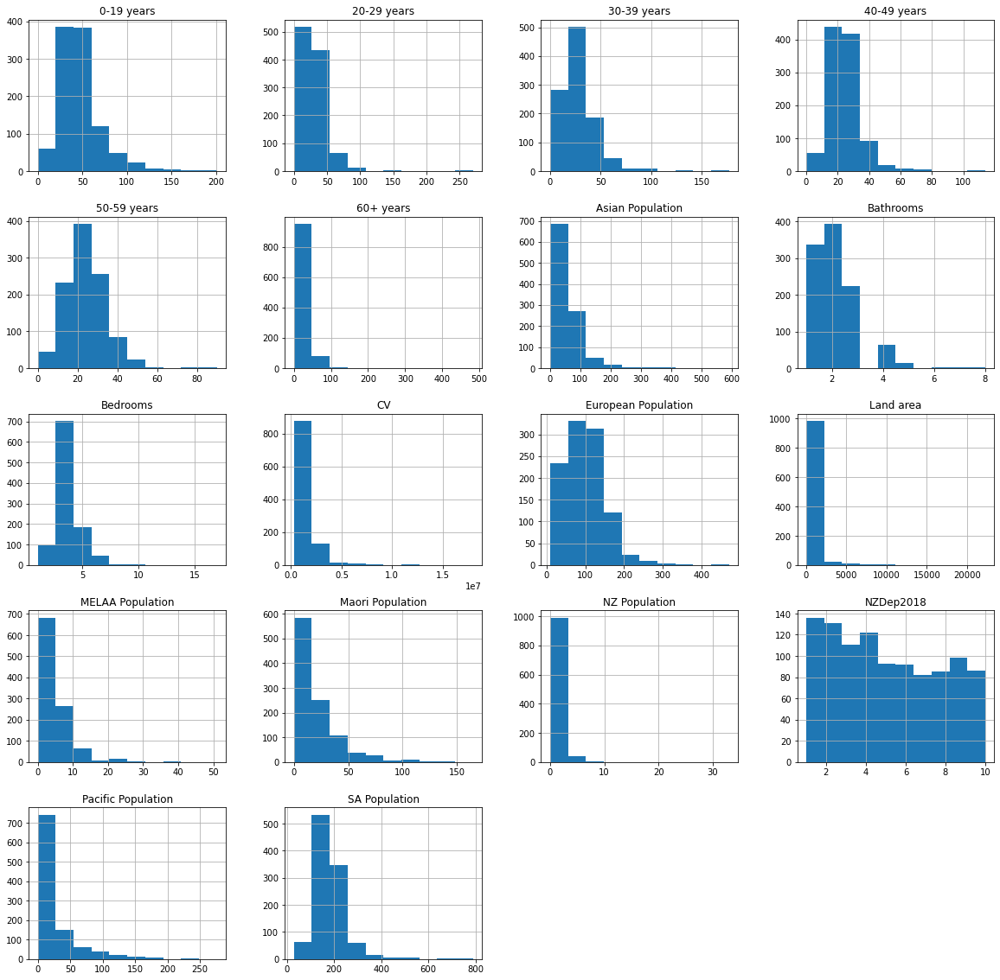

In [83]:
propertiesDeprivation.hist(figsize=(20,20))

<AxesSubplot:xlabel='NZDep2018'>

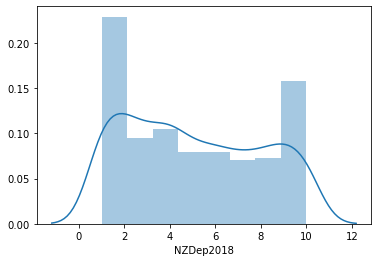

In [129]:
sns.distplot(propertiesDeprivation['NZDep2018'])


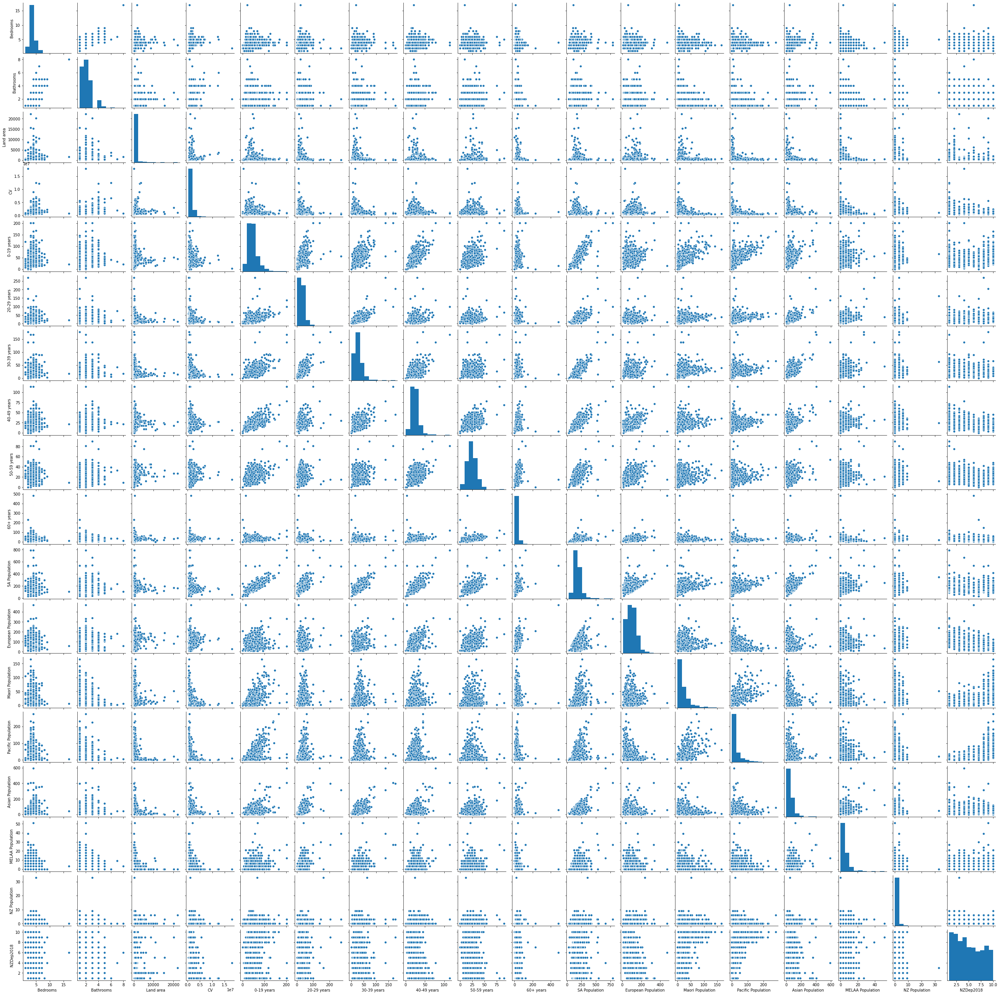

In [92]:
sns.pairplot(propertiesDeprivation, size=2.0)
plt.show()

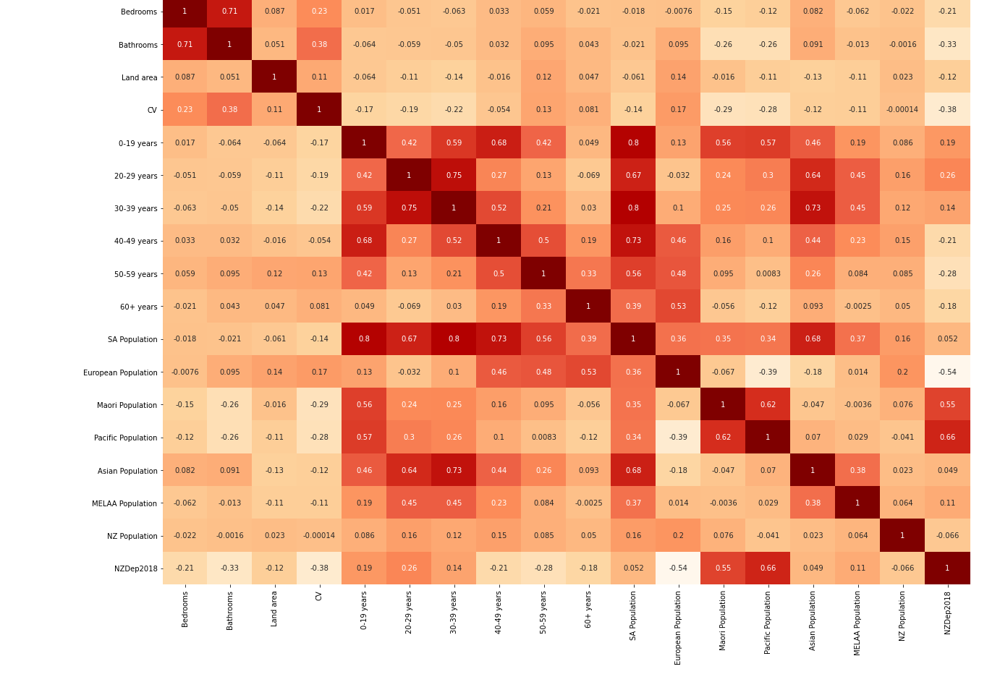

In [168]:
ax, fig = plt.subplots(figsize=(25, 15))
corr_matrix = propertiesDeprivation.corr()
sns.heatmap(corr_matrix, annot=True, cmap="OrRd")
plt.show()

In [152]:
import sklearn.linear_model
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

model = LinearRegression()

x = propertiesDeprivation.drop(['NZDep2018', 'Address', 'Suburbs'],axis=1)
x.head()

,Bedrooms,Bathrooms,Land area,CV,0-19 years,20-29 years,30-39 years,40-49 years,50-59 years,60+ years,SA Population,European Population,Maori Population,Pacific Population,Asian Population,MELAA Population,NZ Population
0,5,3,714,960000,48,27,24,21,24,21,174,72,30,51,54,9,0
1,5,3,564,1250000,42,18,12,21,15,30,129,87,21,12,30,0,0
2,6,4,626,1250000,42,18,12,21,15,30,129,87,21,12,30,0,0
3,2,1,65,740000,42,6,21,21,12,15,120,90,9,15,21,6,0
4,3,1,601,630000,93,27,33,30,21,33,231,15,48,177,36,0,0


In [136]:
y = propertiesDeprivation['NZDep2018']
y.head()

0    6.0
1    1.0
2    1.0
3    2.0
4    9.0
Name: NZDep2018, dtype: float64

In [182]:
train_x, test_x, train_y, test_y = train_test_split(x,y,test_size=0.3)

# train_x = train_x.values
train_x = np.asarray(train_x)

std_x = StandardScaler().fit_transform(train_x)

Text(0, 0.5, 'Cumulative explained variance')

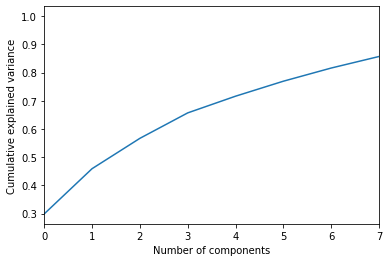

In [159]:
from sklearn.decomposition import PCA
pca = PCA().fit(std_x)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlim(0,7,1)
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')

In [183]:
model.fit(train_x,train_y)
predicted = model.predict(test_x)
model.score(test_x,test_y)

0.7063274094236036

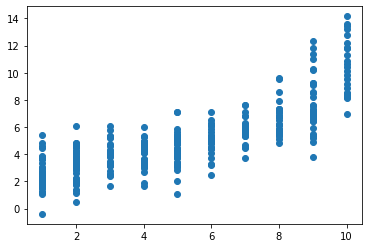

In [140]:
plt.scatter(test_y,predicted)

0.64643015456823